In [1]:
import itertools
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import TensorDataset, Dataset, Subset, ConcatDataset
from pathlib import Path
import numpy as np
from tqdm import tqdm
import abc
import wandb
from torchvision import transforms as T
from byol_pytorch import BYOL
from scipy.spatial.transform import Rotation as R
from PIL import Image
import torchvision
import json
from torch.utils.data import DataLoader
import os
import pickle as pkl

# create abstract Dataset class called StickDataset
import cv2


from utils.r3D_semantic_dataset import load_depth
from utils.metrics import get_act_mean_std
from utils.traverse_data import iter_dir_for_traj_pths


class BaseStickDataset(Dataset, abc.ABC):
    def __init__(self, traj_path, time_skip, time_offset, time_trim):
        super().__init__()
        self.traj_path = Path(traj_path)
        self.time_skip = time_skip
        self.time_offset = time_offset
        self.time_trim = time_trim
        self.img_pth = self.traj_path / "images"
        self.depth_pth = self.traj_path / "depths"
        self.conf_pth = self.traj_path / "confs"
        self.labels_pth = self.traj_path / "labels.json"

        self.labels = json.load(self.labels_pth.open("r"))
        self.img_keys = sorted(self.labels.keys())
        # lable structure: {image_name: {'xyz' : [x,y,z], 'rpy' : [r, p, y], 'gripper': gripper}, ...}

        self.labels = np.array(
            [self.flatten_label(self.labels[k]) for k in self.img_keys]
        )

        # filter using time_skip and time_offset and time_trim. start from time_offset, skip time_skip, and remove last time_trim
        self.labels = self.labels[: -self.time_trim][self.time_offset :: self.time_skip]

        # filter keys using time_skip and time_offset and time_trim. start from time_offset, skip time_skip, and remove last time_trim
        self.img_keys = self.img_keys[: -self.time_trim][
            self.time_offset :: self.time_skip
        ]

    def flatten_label(self, label):
        # flatten label
        xyz = label["xyz"]
        rpy = label["rpy"]
        gripper = label["gripper"]
        return np.concatenate((xyz, rpy, np.array([gripper])))

    def __len__(self):
        return len(self.img_keys)

    def __getitem__(self, idx):
        # not implemented

        raise NotImplementedError


class StickDataset(BaseStickDataset, abc.ABC):
    def __init__(
        self, traj_path, traj_len, time_skip, time_offset, time_trim, traj_skip
    ):
        super().__init__(traj_path, time_skip, time_offset, time_trim)
        self.traj_len = traj_len
        self.traj_skip = traj_skip
        self.reformat_labels(self.labels)
        self.act_metrics = None

    def set_act_metrics(self, act_metrics):
        self.act_metrics = act_metrics

    def reformat_labels(self, labels):
        # reformat labels to be delta xyz, delta rpy, next gripper state
        new_labels = np.zeros_like(labels)
        new_img_keys = []

        for i in range(len(labels) - 1):
            if i == 0:
                current_label = labels[i]
                next_label = labels[i + 1]
            else:
                next_label = labels[i + 1]

            current_matrix = np.eye(4)
            r = R.from_euler("xyz", current_label[3:6], degrees=False)
            current_matrix[:3, :3] = r.as_matrix()
            current_matrix[:3, 3] = current_label[:3]

            next_matrix = np.eye(4)
            r = R.from_euler("xyz", next_label[3:6], degrees=False)
            next_matrix[:3, :3] = r.as_matrix()
            next_matrix[:3, 3] = next_label[:3]

            delta_matrix = np.linalg.inv(current_matrix) @ next_matrix
            delta_xyz = delta_matrix[:3, 3]
            delta_r = R.from_matrix(delta_matrix[:3, :3])
            delta_rpy = delta_r.as_euler("xyz", degrees=False)

            del_gripper = next_label[6] - current_label[6]
            xyz_norm = np.linalg.norm(delta_xyz)
            rpy_norm = np.linalg.norm(delta_r.as_rotvec())

            if xyz_norm < 0.01 and rpy_norm < 0.008 and abs(del_gripper) < 0.05:
                # drop this label and corresponding image_key since the delta is too small (basically the same image)
                continue

            new_labels[i] = np.concatenate(
                (delta_xyz, delta_rpy, np.array([next_label[6]]))
            )
            new_img_keys.append(self.img_keys[i])
            current_label = next_label

        # remove labels with all 0s
        new_labels = new_labels[new_labels.sum(axis=1) != 0]
        assert len(new_labels) == len(new_img_keys)
        self.labels = new_labels
        self.img_keys = new_img_keys

    def load_labels(self, idx):
        # load labels with window size of traj_len, starting from idx and moving window by traj_skip
        labels = self.labels[
            idx * self.traj_skip : idx * self.traj_skip + self.traj_len
        ]
        # normalize labels
        if self.act_metrics is not None:
            labels = (labels - self.act_metrics["mean"].numpy()) / self.act_metrics[
                "std"
            ].numpy()
        return labels

    def get_img_pths(self, idx):
        # get image paths with window size of traj_len, starting from idx and moving window by traj_skip
        img_keys = self.img_keys[
            idx * self.traj_skip : idx * self.traj_skip + self.traj_len
        ]
        img_pths = [self.img_pth / k for k in img_keys]
        return img_pths

    def __len__(self):
        return (len(self.img_keys) - self.traj_len) // self.traj_skip + 1

    def __getitem__(self, idx):
        if idx < 0 or idx >= len(self):
            raise IndexError()
        return None, self.load_labels(idx)


class ImageStickDataset(StickDataset):
    def __init__(
        self,
        traj_path,
        traj_len,
        time_skip,
        time_offset,
        time_trim,
        traj_skip,
        img_size,
        pre_load=False,
        transforms=None,
    ):
        super().__init__(
            traj_path, traj_len, time_skip, time_offset, time_trim, traj_skip
        )
        self.img_size = img_size
        self.pre_load = pre_load
        self.transforms = transforms
        self.preprocess_img_transforms = torchvision.transforms.Compose(
            [
                torchvision.transforms.Resize(self.img_size),
                torchvision.transforms.ToTensor(),
            ]
        )
        if self.pre_load:
            self.imgs = self.load_imgs()

    def load_imgs(self):
        # load images in uint8 with window size of traj_len, starting from idx and moving window by traj_skip
        imgs = []

        for key in tqdm(self.img_keys):
            img = Image.open(str(self.img_pth / key))
            img = self.preprocess_img_transforms(img)
            imgs.append(img)
        # add a nex axis at the beginning
        imgs = torch.stack(imgs, dim=0)
        return imgs

    def __getitem__(self, idx):
        _, labels = super().__getitem__(idx)

        if self.pre_load:
            imgs = self.imgs[
                idx * self.traj_skip : idx * self.traj_skip + self.traj_len
            ]
        else:
            imgs = []
            for key in self.img_keys[
                idx * self.traj_skip : idx * self.traj_skip + self.traj_len
            ]:
                img = Image.open(str(self.img_pth / key))
                img = self.preprocess_img_transforms(img)
                imgs.append(img)
            # add a nex axis at the beginning
            imgs = torch.stack(imgs, dim=0)

        if self.transforms:
            imgs = self.transforms(imgs)

        return imgs, labels


In [2]:
def get_image_stick_dataset(
    data_path,
    traj_len=1,
    traj_skip=1,
    time_skip=4,
    time_offset=5,
    time_trim=5,
    img_size=224,
    pre_load=True,
    apply_transforms=True,
    val_mask=None,
    mask_texts=None,
    cfg=None,
):
    # add transforms for normalization and converting to float tensor
    if type(data_path) == str:
        data_path = Path(data_path)

    if apply_transforms:
        transforms = torchvision.transforms.Compose(
            [
                torchvision.transforms.Normalize(
                    mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
                )
            ]
        )
    else:
        transforms = None

    train_traj_paths, val_traj_paths, test_traj_paths = iter_dir_for_traj_pths(
        data_path, val_mask, mask_texts
    )
    # train_traj_paths = train_traj_paths[:64]
    # val_traj_paths = val_traj_paths[:16]
    # test_traj_paths = test_traj_paths[:16]
    # concatenate all the Datasets for all the trajectories
    train_dataset = ConcatDataset(
        [
            ImageStickDataset(
                traj_path,
                traj_len,
                time_skip,
                time_offset_n,
                time_trim,
                traj_skip,
                img_size,
                pre_load=pre_load,
                transforms=transforms,
            )
            for traj_path, time_offset_n in itertools.product(
                train_traj_paths, [time_offset, time_offset + 2]
            )
        ]
    )

    

    if len(val_traj_paths) > 0:
        val_dataset = ConcatDataset(
            [
                ImageStickDataset(
                    traj_path,
                    traj_len,
                    time_skip,
                    time_offset,
                    time_trim,
                    traj_skip,
                    img_size,
                    pre_load=pre_load,
                    transforms=transforms,
                )
                for traj_path in val_traj_paths
            ]
        )
        
    else:
        val_dataset = None

    if len(test_traj_paths) > 0:
        test_dataset = ConcatDataset(
            [
                ImageStickDataset(
                    traj_path,
                    traj_len,
                    time_skip,
                    time_offset,
                    time_trim,
                    traj_skip,
                    img_size,
                    pre_load=pre_load,
                    transforms=transforms,
                )
                for traj_path in test_traj_paths
            ]
        )
    else:
        test_dataset = None

    return train_dataset, val_dataset, test_dataset

In [3]:
val_mask = {'home': [],
  'env': [],
  'traj': ['2023-04-11--23-20-07_0', '2023-04-11--23-20-22_0']}

apply_transforms = True  ## We apply transforms now for normalizing the image
img_size = [224, 224]

In [4]:
train, val, test = get_image_stick_dataset(data_path='data/Benchmarking_Export/Door_Opening/CDS_Home/Env1', img_size=img_size, val_mask = val_mask, apply_transforms = apply_transforms)

Iterating through:  data/Benchmarking_Export/Door_Opening/CDS_Home/Env1
Total number of trajectories:  24
total number of train trajectories:  24
total number of test trajectories:  0
Total number of val trajectories:  2


100%|██████████| 31/31 [00:00<00:00, 147.76it/s]


## Models

In [5]:
##TODO: Add your encoder class from the byol notebook here and run the cell

In [19]:
class VINN(nn.Module):
    def __init__(self, encoder, enc_weight_pth=None, cfg=None):
        super(VINN, self).__init__()
        self.encoder = encoder
        self.cfg = cfg

        self.k = 5


        if enc_weight_pth is not None:
            self.encoder.load_state_dict(torch.load(enc_weight_pth))

        self.representations = None
        self.actions = None
        self.img_pths = None
        self.imgs = None
        softmax = nn.Softmax(dim=1)
        self.dist_scale_func = lambda x: ?? ## Function to scale the distances of neighbors for weighted averaging
        self.encoder.eval()
        self.device = "cpu"



    def to(self, device):
        super().to(device)
        self.device = device
        self.encoder.to(device)

    def set_dataset(self, dataloader):
        self.bs = dataloader.batch_size
        for dataset in tqdm(dataloader.dataset.datasets):
            
            for i, (image, label) in enumerate(dataset):
                image = image.to(self.device)
                label = torch.Tensor(label).to("cpu").detach()
                pth = dataset.get_img_pths(i)[0]
                representation = ??
                if self.representations is None:
                    self.representations = representation
                    self.actions = label
                    self.img_pths = [pth]
                    self.imgs = [image.to("cpu").detach().numpy()]
                else:
                    self.representations = torch.cat(
                        (self.representations, representation), 0
                    )
                    self.actions = torch.cat((self.actions, label), 0)
                    self.img_pths.append(pth)
                    self.imgs.append(image.to("cpu").detach().numpy())

                    
    def get_action(self, img, return_indices=False):
        self.encoder.eval()
        with torch.no_grad():
            if return_indices:
                act, indices = self(img, return_indices=True)
            else:
                act = self(img).squeeze().detach()
            act = self.denorm_action(act)

        return act if not return_indices else (act, indices)

    def __call__(self, batch_images, k=None, return_indices=False):
        if k is None:
            k = self.k

        #TODO: Write the code here. Your task it to use a batch of images, calculate nearest neighbors form the loaded dataset and return 
        #weighted actions as predictions
        
        #HINT: try to use torch.cdist and torch.topk

        ##Block of code here: Convert the input images to representations and make sure all the relevant variables in in proper device##
        
        
        ########
        all_distances = ??

        top_k_distances, indices = ??
        top_k_actions = ??
        weights = self.dist_scale_func(top_k_distances.to(self.device))
        pred = torch.sum(top_k_actions * weights.unsqueeze(-1), dim=1)

        if return_indices:
            return pred, indices

        return pred

    
    
    
    ### the bottom code is used to save the model weights and representations, can ignore for now
    def save_state_variables(self, save_path):
        save_vars = [
            self.representations,
            self.actions,
            self.img_pths,
            self.imgs,
        ]
        save_var_names = [
            "representations",
            "actions",
            "img_pths",
            "imgs",
        ]
        save_dict = {}
        for i, var in enumerate(save_vars):
            save_dict[save_var_names[i]] = var
        pkl.dump(save_dict, open(save_path, "wb"))

        # also save encder weights with same name but .pth extension
        torch.save(self.encoder.state_dict(), save_path[:-4] + ".pth")

    def load_state_variables(self, load_path):
        print("Loading state variables from {}".format(load_path))
        load_dict = pkl.load(open(load_path, "rb"))
        self.representations = load_dict["representations"]
        self.actions = load_dict["actions"]

        self.img_pths = load_dict["img_pths"]
        if "imgs" in load_dict:
            self.imgs = load_dict["imgs"]



        self.encoder.load_state_dict(torch.load(load_path[:-4] + ".pth"))
        self.encoder.eval()

## Trainers

In [7]:
from abc import ABC, abstractmethod


#Base trainer class
class Trainer(ABC):
    def __init__(
        self, model, optimizer, scheduler, device, experiment, save_every, cfg
    ):
        self.model = model
        self.optimizer = optimizer
        self.scheduler = scheduler
        self.device = device
        self.experiment = experiment
        self.save_every = save_every
        self.cfg = cfg
    


    @abstractmethod
    def train(self, train_dataloader, val_dataloader, test_dataloader, epochs):
        pass

    @abstractmethod
    def validate(self, dataloader):
        pass

    @abstractmethod
    def test(self, dataloader):
        pass

    def save(self, epoch):
        if not os.path.exists("./weights"):
            os.makedirs("./weights")
        torch.save(self.model.state_dict(), f"./weights/{self.experiment}_{epoch}.pth")

    def load(self, path):
        self.model.load_state_dict(torch.load(path))

In [8]:
from utils.image_plots import overlay_action, display_image_in_grid

class VINNTrainer(Trainer):
    def __init__(
        self,
        model,
        optimizer,
        scheduler,
        device,
        experiment,
        save_every,
        cfg=None,
        max_k=20,
    ):
        super().__init__(
            model, optimizer, scheduler, device, experiment, save_every, cfg
        )
        self.loss_fn = nn.MSELoss()
        self.max_k = max_k
        self.model.eval()

    def train(self, train_dataloader, val_dataloader, test_dataloader, epochs):
        
        self.model.to(self.device)
        self.model.set_dataset(train_dataloader)
        for k in tqdm(range(1, self.max_k + 1)):
            val_loss = 0
            translation_val_loss = 0
            rotation_val_loss = 0
            gripper_val_loss = 0

            for i, (x, y) in enumerate(val_dataloader):
                x = x.to(self.device)
                x = x.squeeze()
                y = y.to(self.device)
                y = y.squeeze()

                y_hat = ??
                #HINT: The action space is 7 dimensions, with first 3 being translation (delta x,y,z), next 3 being rotation (delta r,p,y) and final being gripper (value between 0-1)
                loss = ??
                translation_val_loss += ??
                rotation_val_loss += ??
                gripper_val_loss += ??

                val_loss += loss.item()
                
            val_loss /= len(val_dataloader)
            translation_val_loss /= len(val_dataloader)
            rotation_val_loss /= len(val_dataloader)
            gripper_val_loss /= len(val_dataloader)

            wandb.log({"val_loss": val_loss}, step=k)
            wandb.log({"translation_val_loss": translation_val_loss}, step=k)
            wandb.log({"rotation_val_loss": rotation_val_loss}, step=k)
            wandb.log({"gripper_val_loss": gripper_val_loss}, step=k)

        if not os.path.exists("./weights"):
            os.makedirs("./weights")

        self.model.save_state_variables(f"./weights/{self.experiment}.pkl")

        
        
        
    ##Code for visualising the nearest neighbors. Can ignore for now
    def eval_dataset(
        self, dataset, k=4, start=None, end=None, plot_freq=1, vector_scale=14
    ):
        img_grid = []
        label_grid = []
        loss = 0

        for i, (x, y) in enumerate(dataset):
            if start is not None and i < start:
                continue
            if end is not None and i > end:
                break

            query_img = cv2.imread(str(dataset.get_img_pths(i)[0]))

            y = torch.from_numpy(y).to(self.device)
            x = x.to(self.device)

            action = y
#             action = self.model.denorm_action(normalzed_action)
            action = action.squeeze().detach().cpu().numpy()

            query_img = overlay_action(
                action, query_img, color=(0, 255, 0), vector_scale=vector_scale
            )

            y_hat, indices = self.model(x, k, return_indices=True)

            pred_action = y_hat.squeeze().detach()
#             pred_action = self.model.denorm_action(nromalized_pred_action)

            l = self.loss_fn(y_hat, y)
            loss += l

            query_img = overlay_action(
                pred_action.cpu().numpy(),
                query_img,
                color=(255, 0, 0),
                vector_scale=vector_scale,
                shift_start_point=True,
            )

            if plot_freq != 0 and i % plot_freq == 0:
                img_grid.append([])
                label_grid.append([])
                img_grid[-1].append(query_img)
                label_grid[-1].append("query, loss {:.3f}".format(l.item()))

                # label_grid[-1].append('query, loss {:.3f}'.format(l.item()) + \
                #     'p: '+str(y_hat.squeeze().detach().cpu().numpy()) + \
                #     'a: '+str(y.squeeze().detach().cpu().numpy()))

                indices = indices[0]
                for j in range(k):
                    img = cv2.imread(str(self.model.img_pths[indices[j]]))
                    nbhr_action = (
                        self.model.actions[indices[j]].to(self.device)
                        .squeeze()
                        .detach()
                        .cpu()
                        .numpy()
                    )
                    img = overlay_action(
                        nbhr_action, img, color=(0, 255, 0), vector_scale=vector_scale
                    )
                    if plot_freq != 0 and i % plot_freq == 0:
                        img_grid[-1].append(img)
                        label_grid[-1].append("nbhr")

        loss /= len(dataset)
        if plot_freq != 0:
            display_image_in_grid(img_grid, label_grid)
        return loss

    def validate(self, dataloader):
        pass

    def test(self, dataloader):
        pass


## Training

### Fitting VINN

In [9]:
experiment = "Tutorial_VINN"
save_every = None

In [10]:
train_loader = DataLoader(
    train,
    batch_size=bs,
    shuffle=True,
    num_workers=num_workers,
    pin_memory=True,
)

val_loader = DataLoader(
    val,
    batch_size=bs,
    shuffle=True,
    num_workers=num_workers,
    pin_memory=True,
)

In [11]:
encoder = ??
model = ??

/ext3/py3.9/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/ext3/py3.9/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [13]:
wandb_run = wandb.init(
    project = experiment
)

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: raianant (use `wandb login --relogin` to force relogin)
wandb: wandb version 0.15.3 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


In [14]:
vinn_trainer = VINNTrainer(
                model = model, 
                optimizer = None, 
                scheduler = None, 
                device = 'cuda', 
                experiment = experiment, 
                save_every = save_every)

In [15]:
vinn_trainer.train(
    train_loader, val_loader, None, epochs
)

100%|██████████| 20/20 [00:10<00:00,  1.94it/s]


In [41]:
wandb.finish()

gripper_val_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
rotation_val_loss,█▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
translation_val_loss,█▅▄▃▃▃▃▃▂▂▁▁▁▁▁▁▁▁▁▁
val_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
gripper_val_loss,0.01739
rotation_val_loss,0.00012
translation_val_loss,0.00013
val_loss,0.00259


## Visualising nearest neighbors 

In [42]:
vinn_trainer.eval_dataset(val.datasets[0], k = 4, plot_freq = 2)

tensor(0.0019, device='cuda:0', dtype=torch.float64)

In [45]:
vinn_trainer.eval_dataset(val.datasets[1], k = 4, plot_freq = 2)

tensor(0.0009, device='cuda:0', dtype=torch.float64)

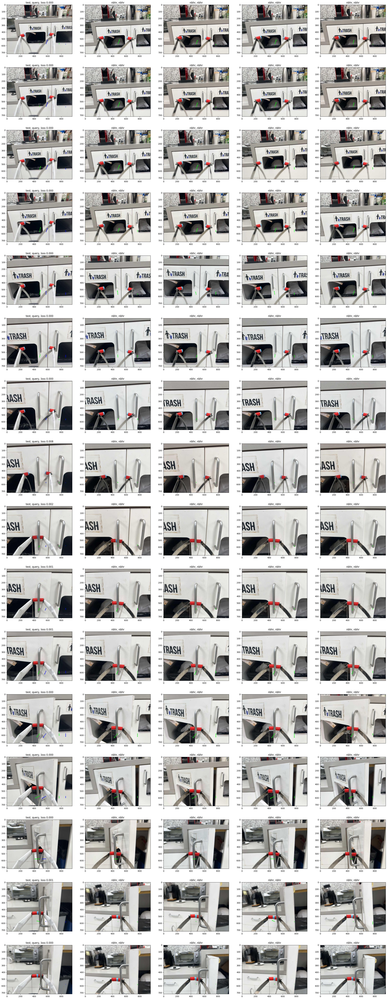

In [17]:
vinn_trainer.eval_dataset(val.datasets[1], k = 4, plot_freq = 2)